# Homework 2 part 2: NDVI raster analysis using NAIP imagery
### Cleaned notebook by Jamie Song for MUSA 6950

This notebook will begin by downloading the natural color and false color NAIP images from a database maintained by Microsoft. We need to download NAIP tiles first before doing any raster-based operations, like, mosaci, clip, mask, etc.

Instead of Philadelphia, we will focus on San Francisco and use a publicly available geojson of the city limits to download NAIP images for the city from 2016.


In [1]:
# install packages not in environment
!pip install pystac_client
!pip install planetary_computer
!pip install rioxarray
!pip install pygris


In [2]:
# import necessary libraries
import os
import os.path
import pystac_client
from pystac_client import Client
import planetary_computer as pc
import rioxarray
import rasterio as rio
import fiona
import pyproj
import requests
from shapely.geometry import shape, Point, Polygon, mapping
from functools import partial
from shapely.ops import transform
import urllib.request
import numpy as np
import geopandas as gpd
from matplotlib import pyplot as plt
from rasterio.plot import show
from rasterio.mask import mask
from rasterio.windows import get_data_window, Window
from rasterio.merge import merge
import warnings
import pygris
from pygris import requests, tracts
from pyproj import Transformer
from fiona.transform import transform_geom
import glob
import shapely

# set working directory if needed
os.chdir('/Users/songj/Documents/GitHub/ai-urban-sustainability/hw2/')

# we will use Professor Li's API key here
pc.settings.set_subscription_key("st=2022-06-01T22%3A55%3A32Z&se=2022-06-02T23%3A40%3A32Z&sp=rl&sv=2020-06-12&sr=c&skoid=c85c15d6-d1ae-42d4-af60-e2ca0f81359b&sktid=72f988bf-86f1-41af-91ab-2d7cd011db47&skt=2022-06-02T20%3A23%3A33Z&ske=2022-06-09T20%3A23%3A33Z&sks=b&skv=2020-06-12&sig=U5e1SoZGZqIcunum5BKWcmsVi2bmS1tBsr94LPI%2BLoc%3D")


In [3]:
# optional - turn off warnings
warnings.filterwarnings('ignore')

In [4]:
# initialize pystac client
catalog = pystac_client.Client.open(
    "https://planetarycomputer.microsoft.com/api/stac/v1",
    modifier = pc.sign_inplace,
)

In [6]:
# download and save the geojson file for San Francisco
url = "https://github.com/ResidentMario/geoplot-data/raw/refs/heads/master/san-francisco.geojson"
geojson_path = "san-francisco.geojson"

response = requests.get(url)
with open(geojson_path, "wb") as file:
    file.write(response.content)

# open the SF geojson file
lyr = fiona.open(geojson_path)

# extract the geometry
for feat in lyr:
    area_of_interest_city = feat["geometry"]
    break 

left, bottom, right, top = lyr.bounds
area_of_interest = {
    "type": "Polygon",
    "coordinates": [
        [
            [left, bottom],
            [right, bottom],
            [right, top],
            [left, top],
            [left, bottom],
        ]
    ],
}

# examine the coordinates for area of interest
print(area_of_interest)


{'type': 'Polygon', 'coordinates': [[[-122.514948, 37.708089], [-122.356967, 37.708089], [-122.356967, 37.811574], [-122.514948, 37.811574], [-122.514948, 37.708089]]]}


Let's make sure that there are image files available for our desired geographic bounds and time range (San Francisco, 2016).

In [7]:
## check on GEE, https://developers.google.com/earth-engine/datasets/catalog/USDA_NAIP_DOQQ
range_time = '2016-05-01' + '/' + '2016-10-30'

search_new = catalog.search(
    collections=["naip"], intersects=area_of_interest, datetime=range_time
)

items_tiles = search_new.item_collection()

print(f"{len(items_tiles)} Items found in the 'new' range")

12 Items found in the 'new' range


Now that we know there were items found in the time range, we will proceed to download the NAIP images. We define a function called "naip_downloader" to handle this process.

In [8]:
def naip_downloader(shpfile, outfolder, startDate, endDate):
    '''This function will use the shapefile as the limit and find the 
    tiles that overlap with the shapefile and then download those tiles
    
    Parameters:
        shpfile: the shapefile of the city limit
        outfolder: the output folder of the NAIP images
        startDate: the start date to check the NAIP inventory, year-month-day, 2017-06-01/2017-09-30
        endDate: the end date to check the available NAIP year-month-day, 2017-06-01/2017-09-30
    '''
    
    import fiona
    
    lyr = fiona.open(geojson_path)
    for feat in lyr:
        area_of_interest_city = feat['geometry']
        # print(area_of_interest)
    
    left, bottom, right, top = lyr.bounds
    area_of_interest = {
        "type": "Polygon",
        "coordinates": [
            [
                [left, bottom],
                [right, bottom],
                [right, top],
                [left, top],
                [left, bottom],
            ]
        ],
    }
    
    print(area_of_interest)
    
    range_time = startDate + '/' + endDate
    print(range_time)
    
    catalog = Client.open("https://planetarycomputer.microsoft.com/api/stac/v1")
    
    search_tiles = catalog.search(
        collections=["naip"], intersects=area_of_interest, datetime=range_time
    )
    items_tiles = list(search_tiles.get_items())
    print(f"{len(items_tiles)} Items found in the range %s"%(range_time))
    # print(items_tiles)
    
    ## loop all the intersected tiles and download them all
    for item in items_tiles:
        # href = pc.sign(item.assets["image"].href)
        href = item.assets["image"].href
        
        outfilename = os.path.join(outfolder, item.id + ".tif")
        urllib.request.urlretrieve(href, outfilename)

        ### check if the NAIP tile intersects with the shapefile, if not remove it.
        lu_dataset = rio.open(outfilename)
        epsgcode = lu_dataset.crs.to_epsg()
        lu_bounds = lu_dataset.bounds
        lu_box = Polygon([(lu_bounds.left, lu_bounds.bottom), \
                            (lu_bounds.left, lu_bounds.top), \
                            (lu_bounds.right, lu_bounds.top), \
                            (lu_bounds.right, lu_bounds.bottom)])
        
        city_geom = shape(area_of_interest_city)
        #print('city_geom is:', city_geom)
        #print("The lubox is:", lu_box)
        
        project = pyproj.Transformer.from_proj(
            pyproj.Proj('epsg:4326'), # source coordinate system
            pyproj.Proj('epsg:%s'%(epsgcode)), 
            always_xy=True) # destination coordinate system
        city_geom_proj = transform(project.transform, city_geom)  # apply projection
        
        ## make sure the projections are consistent
        if city_geom_proj.intersects(lu_box):
            print("intersected :", outfilename)
            r = lu_dataset.read(1) ## start from 1, 2, 3, 4
            g = lu_dataset.read(2)
            b = lu_dataset.read(3)
            ir = lu_dataset.read(4)
            #rgb = np.dstack((r,g,b))
            cir = np.stack((ir,r,g,b))
            
            out_meta = lu_dataset.meta.copy()
            out_meta.update({'count': 4})
            # os.remove(outfilename)
            with rio.open(outfilename, "w", **out_meta) as dest:
                dest.write(cir)
        else:
            print("The CIR is not intersected, remove it=--------")
            os.remove(outfilename)
        

In [9]:
# using the reprojected geom shape to find the corresponding tile
cir_naips = 'cir-naip'
if not os.path.exists(cir_naips): os.mkdir(cir_naips)

# check on GEE, https://developers.google.com/earth-engine/datasets/catalog/USDA_NAIP_DOQQ
startDate = '2016-01-01'
endDate = '2016-12-30'
naip_downloader(geojson_path, cir_naips, startDate, endDate)


{'type': 'Polygon', 'coordinates': [[[-122.514948, 37.708089], [-122.356967, 37.708089], [-122.356967, 37.811574], [-122.514948, 37.811574], [-122.514948, 37.708089]]]}
2016-01-01/2016-12-30
12 Items found in the range 2016-01-01/2016-12-30
intersected : cir-naip/ca_m_3712221_nw_10_.6_20160625_20161004.tif
intersected : cir-naip/ca_m_3712221_ne_10_.6_20160625_20161004.tif
intersected : cir-naip/ca_m_3712220_ne_10_.6_20160625_20161004.tif
intersected : cir-naip/ca_m_3712213_sw_10_.6_20160625_20161004.tif
intersected : cir-naip/ca_m_3712213_se_10_.6_20160625_20161004.tif
The CIR is not intersected, remove it=--------
intersected : cir-naip/ca_m_3712213_ne_10_.6_20160625_20161004.tif
intersected : cir-naip/ca_m_3712212_se_10_.6_20160625_20161004.tif
The CIR is not intersected, remove it=--------
intersected : cir-naip/ca_m_3712222_nw_10_.6_20160531_20161004.tif
intersected : cir-naip/ca_m_3712214_sw_10_.6_20160531_20161004.tif
The CIR is not intersected, remove it=--------


### Visualizing a single TIF file

Here, we will visualize just one of the TIF images our NAIP downloader obtained.

In [10]:
tiffile = 'cir-naip/ca_m_3712213_se_10_.6_20160625_20161004.tif'
dataset = rio.open(tiffile)
dataset.crs

CRS.from_epsg(26910)

In [11]:
band1 = dataset.read(1)

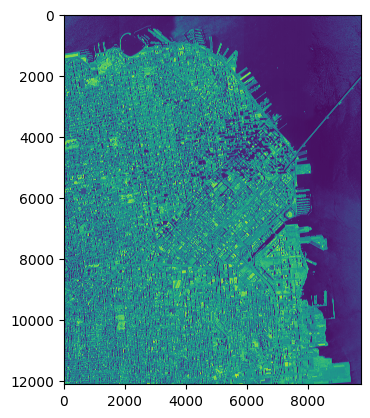

In [12]:
plt.imshow(band1)

## Raster data operations part 1

Raster data are an important format of spatial data. In this tutorial, we are going to using Python to manipulate the raster data format. We will work with `rasterio` and `numpy` for the raster data processing. `rasterio` is a modern library to work with geospatial data in a gridded format. It excels at providing an easy way to read/write raster data and access individual bands and pixels as numpy arrays.

`rasterio` is built on top of the popular GDAL (Geospatial Data Abstraction Library). GDAL is written in C++ so the Python API provided by GDAL is not very intuitive for Python users. `rasterio` aims to make it easy for Python users to use the underlying GDAL library in an intuitive way.

In this section, we will read and write raster data using `rasterio`.

### Read the raster data and get the metadata of the raster data

Here, we will download the NAIP tiles for San Francisco. Then we can check the data and perform analyses on the raster data.

In [13]:
naip_file = 'cir-naip/ca_m_3712213_se_10_.6_20160625_20161004.tif'
naip_dataset = rio.open(naip_file)
naip_bounds = naip_dataset.bounds
naip_bounds

BoundingBox(left=549360.0, bottom=4178076.0, right=555210.0, top=4185348.0)

In [14]:
naip_dataset.crs

CRS.from_epsg(26910)

In [15]:
naip_dataset.meta

{'driver': 'GTiff',
 'dtype': 'uint8',
 'nodata': None,
 'width': 9750,
 'height': 12120,
 'count': 4,
 'crs': CRS.from_epsg(26910),
 'transform': Affine(0.6, 0.0, 549360.0,
        0.0, -0.6, 4185348.0)}

Now, we can read the geotiff image for different bands.

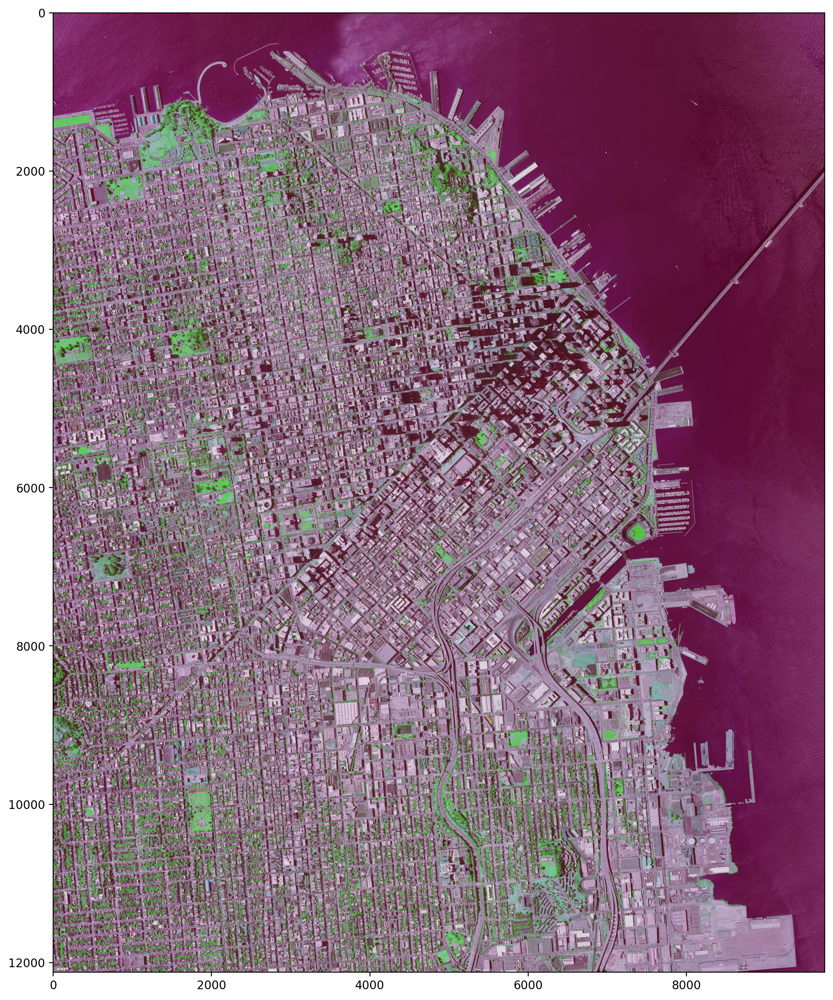

In [16]:
naip_file = 'cir-naip/ca_m_3712213_se_10_.6_20160625_20161004.tif'
naip_dataset = rio.open(naip_file)

# read the different bands of the raster data
nir = np.float32(naip_dataset.read(4))
blue = np.float32(naip_dataset.read(3))
green = np.float32(naip_dataset.read(2))
red = np.float32(naip_dataset.read(1))


# stack different layer images
cir = np.dstack((nir,red,green))


# plt.imshow(band1)
plt.figure(figsize=(15, 15), dpi=200)
plt.imshow(cir.astype(np.uint8))

### Display the NAIP image
Here is a function to resmaple the images for display. In some cases, we need to unsample raster data for visualization.

Resampling to 6060,4875


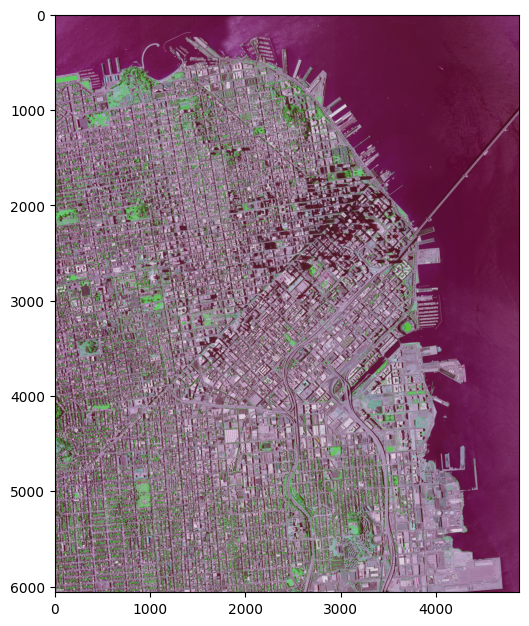

In [18]:
def display_naip_tile(filename, dsfactor = 2):
    """
    Display a NAIP tile using rasterio.
    
    dsfactor: downsample factor
    For .mrf-formatted tiles (which span multiple files), 'filename' should refer to the 
    .mrf file.
    """
    
    # NAIP tiles are enormous; downsize for plotting in this notebook
    
    
    with rio.open(filename) as raster:
        # rasterio uses 1-based indexing for channels.
        h = int(raster.height/dsfactor)
        w = int(raster.width/dsfactor)
        print('Resampling to {},{}'.format(h,w))
        ir = raster.read(4, out_shape=(1, h, w))
        r = raster.read(1, out_shape=(1, h, w))
        g = raster.read(2, out_shape=(1, h, w))
        
    cir = np.dstack((ir,r,g))
    fig = plt.figure(figsize=(7.5, 7.5), dpi=100, edgecolor='k')
    plt.imshow(cir)
    raster.close()
    
naip_file = 'cir-naip/ca_m_3712213_se_10_.6_20160625_20161004.tif'
display_naip_tile(naip_file)

### Calculate the NDVI from NAIP image

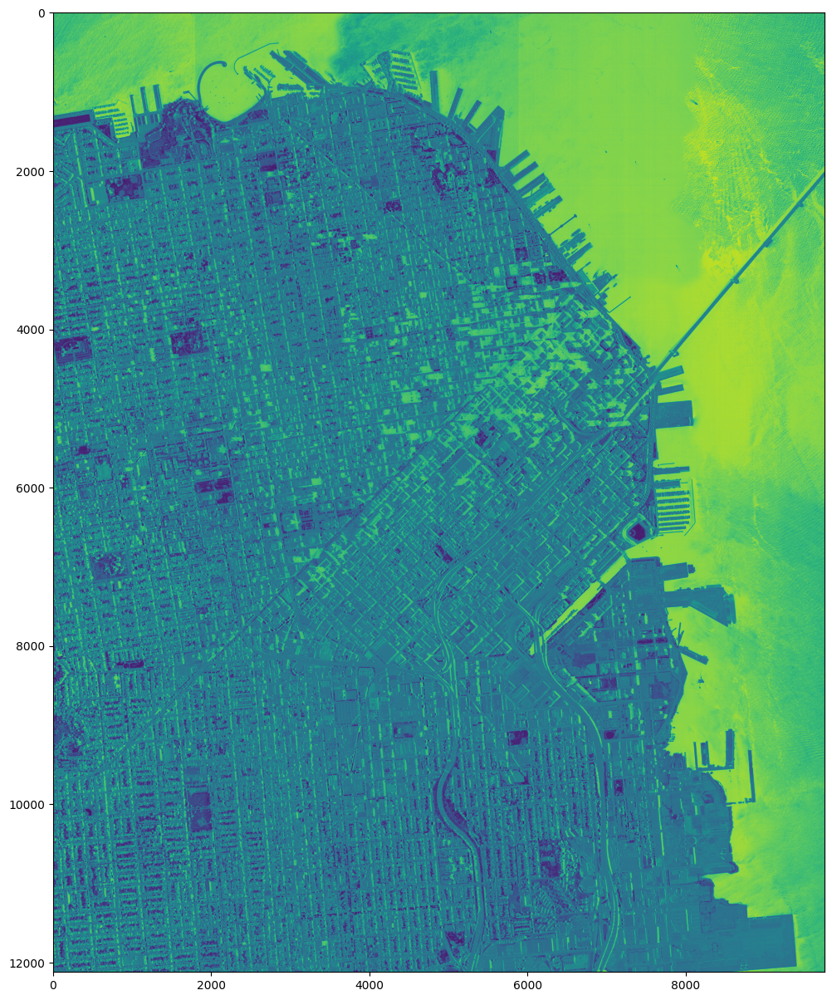

In [19]:
# here add 0.0000001 is to make sure the nir+red is not zero
ndvi = (nir - red)/(nir + red + 0.000001)

plt.figure(figsize=(15, 15))
plt.imshow(ndvi)

In [20]:
# check the statistics of the calcualted NDVI images
ndvi.max()

0.95238096

### Extract vegetation from NAIP image
Since vegetation usually has larger reflectance in the near infrared band than the red band, therefore, we can calculate the NDVI and use the NDVI to extract the vegetation part. 

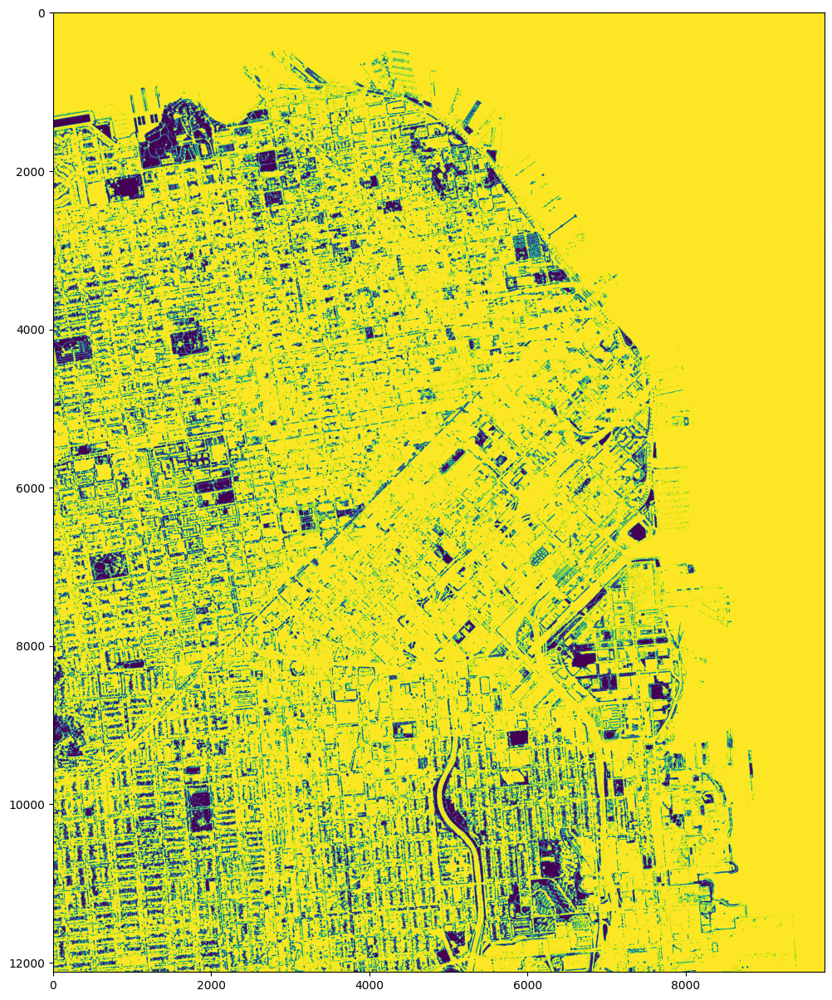

In [31]:
plt.figure(figsize=(15, 15))

veg = np.zeros((ndvi.shape[0], ndvi.shape[1]), dtype = np.uint16)
veg[ndvi > 0] = 1

plt.imshow(veg)

### Save raster data as a new tiff file
We can save our calculated vegetation cover map as a new geotiff file

In [32]:
out_tif = 'data-part2/veg.tiff'

# prepare the schema of the new tiles
out_meta = naip_dataset.meta.copy()

# update the schema of the ndvi image, because it is different from the raw naip image, like only one band
out_meta.update({'count': 1,
                'dtype': 'uint16',
                 "height": ndvi.shape[0],
                 "width": ndvi.shape[1],
                #   "transform": out_transform,
                 "crs": naip_dataset.crs, 
                 'compress': 'lzw'}
               )

# this is required, because rio will use three dimension, even this is single band image
veg = veg.reshape(1, veg.shape[0], veg.shape[1])

with rio.open(out_tif, "w", **out_meta) as dest:
    dest.write(veg)
    

In [33]:
out_meta

{'driver': 'GTiff',
 'dtype': 'uint16',
 'nodata': None,
 'width': 9750,
 'height': 12120,
 'count': 1,
 'crs': CRS.from_epsg(26910),
 'transform': Affine(0.6, 0.0, 549360.0,
        0.0, -0.6, 4185348.0),
 'compress': 'lzw'}

## Raster data operations part 2

In this section, we use `rasterio` to `clip`, `mosaic`, and conduct `zonal` analysis on raster data. 

## Creating a vegetation cover map for San Francisco

Now that we have the NAIP images for all of San Francisco, we can use these images to create a vegetation map of the city. We need to mosaic these images as tiles forming a larger image, and then mask out the relevant pixels using the San Francisco city limits geojson file.

The steps in this process are as follows:
1. Mosaic tiles into larger image
2. Mask the mosaiced tiles using city boundary
3. Chop the masked images into small tiles
4. Calculate the NDVI and create vegetation cover map


### Mosaic tiles into a large raster

In [34]:
pwd

'/Users/songj/Documents/GitHub/ai-urban-sustainability/hw2'

In [ ]:
# This function is used to mosaic geotiffs in the input folder
# Parameters:
#     dirpath: the folder name of the tif files
#     outfile: the output file of the mosaiced geotiff image

inputfolder= 'cir-naip'
outfile = 'data-part2/mosaicied-naip.tif'

# initialize list to mosaic the raster tiles
tiflist = []

for file in os.listdir(inputfolder):    
    if file.endswith('.tif'):
        tiffile = os.path.join(inputfolder, file)
        tiflist.append(tiffile)


src_files_to_mosaic = []
for fp in tiflist:
    try:
        tile_src = rio.open(fp)
        tile_bounds = tile_src.bounds
        
        src_files_to_mosaic.append(tile_src)
    except:
        continue

print('The number of mosaiced tiles is:', len(src_files_to_mosaic))

# the method can be set as min, max
mosaic, out_trans = merge(src_files_to_mosaic) #, method='max'
print('You have mosaiced the results.')


# prepare the schema of the output mosaicied image
out_meta = tile_src.meta.copy()
out_meta.update({"driver": "GTiff",
                  "height": mosaic.shape[1],
                  "width": mosaic.shape[2],
                  "transform": out_trans, 
                  "compress": 'lzw',
                  'BIGTIFF': 'YES'
                  }
               )

#out_fp = os.path.join(dirpath, 'atlanta-naip.tif')
with rio.open(outfile, "w", **out_meta) as dest:
     dest.write(mosaic)


The number of mosaiced tiles is: 9
You have mosaiced the results.


### Mask the mosaiced raster to San Francisco

We can use the SF city limit boundary to restrict the pixels of the imagery.

In [38]:
# download SF geojson as needed
url = "https://github.com/ResidentMario/geoplot-data/raw/refs/heads/master/san-francisco.geojson"
geojson_path = "data-part2/san-francisco.geojson"

response = requests.get(url)
with open(geojson_path, "wb") as file:
    file.write(response.content)

input_value_raster = 'data-part2/mosaicied-naip.tif'
geojson = 'san-francisco.geojson'
out_raster = 'data-part2/maskedSF-naip.tif'

# Define the source and target CRS
source_crs = 'EPSG:4326'  # Example source CRS (WGS84)
target_crs = 'EPSG:26910'  # Example target CRS (Web Mercator)

with fiona.open(geojson, "r") as geojson:
    shapes = transform_geom(source_crs, target_crs, [feature["geometry"] for feature in geojson])

with rio.open(input_value_raster) as src:
    out_image, out_transform = mask(src, shapes, crop=True)
    out_meta = src.meta

out_meta.update({"driver": "GTiff",
                 "height": out_image.shape[1],
                 "width": out_image.shape[2],
                 "compress": 'lzw',
                 "transform": out_transform})

with rio.open(out_raster, "w", **out_meta) as dest:
    dest.write(out_image)    


### Clip a large raster data into small tiles
To reduce file size, we can chop the large raster data into smaller tiles before we calculate the vegetation cover map.

In [6]:
lu_dataset = rio.open('data-part2/maskedSF-naip.tif')
outfolder = 'data-part2/naip-tiles'
if not os.path.exists(outfolder):
    os.mkdir(outfolder)


lu_img = lu_dataset.read()

# height and width of the raster
height, width = lu_dataset.shape

# split the large raser into number of tiles, tile size is 2000*2000
tile_width = 2000
tile_height = 2000

tile_num_col = int(width/tile_width) + 1
tile_num_row = int(height/tile_height) + 1

# the output folder
if not os.path.exists(outfolder): os.mkdir(outfolder)

# create each tile
for i in range(tile_num_row - 1):
    # loop each column
    for j in range(tile_num_col - 1):
        print('The i and j is:', i, j)
        tilename = os.path.join(outfolder, 'row%s-col%s.tif'%(i, j))
        
        row_start = i*tile_height
        col_start = j*tile_width
        row_end = (i + 1)*tile_height
        col_end = (j + 1)*tile_width
        
        # deal with the right boundary
        if row_end > height - 1: tile_height = height - row_start
        if col_end > width - 1: tile_width = width - col_start
        
        # window = get_data_window(lu_dataset.read(1, masked=True))
        window = Window(col_off=col_start, row_off=row_start, width=tile_width, height=tile_height)
        
        kwargs = lu_dataset.meta.copy()
        kwargs.update({
            'height': window.height,
            'width': window.width,
            'transform': rio.windows.transform(window, lu_dataset.transform)})
        
        with rio.open(tilename, 'w', **kwargs) as dst:
            dst.write(lu_dataset.read(window=window))

The i and j is: 0 0
The i and j is: 0 1
The i and j is: 0 2
The i and j is: 0 3
The i and j is: 0 4
The i and j is: 0 5
The i and j is: 0 6
The i and j is: 0 7
The i and j is: 0 8
The i and j is: 0 9
The i and j is: 0 10
The i and j is: 1 0
The i and j is: 1 1
The i and j is: 1 2
The i and j is: 1 3
The i and j is: 1 4
The i and j is: 1 5
The i and j is: 1 6
The i and j is: 1 7
The i and j is: 1 8
The i and j is: 1 9
The i and j is: 1 10
The i and j is: 2 0
The i and j is: 2 1
The i and j is: 2 2
The i and j is: 2 3
The i and j is: 2 4
The i and j is: 2 5
The i and j is: 2 6
The i and j is: 2 7
The i and j is: 2 8
The i and j is: 2 9
The i and j is: 2 10
The i and j is: 3 0
The i and j is: 3 1
The i and j is: 3 2
The i and j is: 3 3
The i and j is: 3 4
The i and j is: 3 5
The i and j is: 3 6
The i and j is: 3 7
The i and j is: 3 8
The i and j is: 3 9
The i and j is: 3 10
The i and j is: 4 0
The i and j is: 4 1
The i and j is: 4 2
The i and j is: 4 3
The i and j is: 4 4
The i and j is: 

Now, we will use a for loop to calculate NDVI values, indicating the extent of vegetation cover.

In [ ]:
# import os
# import numpy as np
# import rasterio as rio
# from rasterio.merge import merge

out_tif = 'data-part2/SFveg.tif'

infolder = 'data-part2/naip-tiles'
outfolder = 'data-part2/veg-tiles'

if not os.path.exists(outfolder):
    os.mkdir(outfolder)

# list to store the file paths of the processed tiles
veg_tiles = []

for file in os.listdir(infolder):
    tiffile = os.path.join(infolder, file)
    
    # read the different bands of the raster data
    if not tiffile.endswith('.tif'): continue
    naip_dataset = rio.open(tiffile)
    green = np.float32(naip_dataset.read(3))
    red = np.float32(naip_dataset.read(2))
    nir = np.float32(naip_dataset.read(1))

    # here add 0.0000001 is to make sure the nir+red is not zero
    ndvi = (nir - red)/(nir + red + 0.000001)
    
    # extract the vegetation based on the ndvi
    veg = np.zeros((ndvi.shape[0], ndvi.shape[1]), dtype = np.uint16)
    veg[ndvi > 0] = 1
    
    # prepare the schema of the new tiles
    out_meta = naip_dataset.meta.copy()

    # update the schema of the ndvi image, because it is different from the raw naip image, like only one band
    out_meta.update({'count': 1,
                    'dtype': 'uint16',
                     "height": ndvi.shape[0],
                     "width": ndvi.shape[1],
                     "crs": naip_dataset.crs, 
                     'compress': 'lzw'}
                   )
    
    # this is required, because rio will use three dimensions, even this is a single band image
    veg = veg.reshape(1, veg.shape[0], veg.shape[1])
    
    out_tile = os.path.join(outfolder, file)
    with rio.open(out_tile, "w", **out_meta) as dest:
        dest.write(veg)
    
    veg_tiles.append(out_tile)

# merge the tiles into a single raster
src_files_to_mosaic = [rio.open(fp) for fp in veg_tiles]
mosaic, out_trans = merge(src_files_to_mosaic)

# update the metadata for the mosaic
out_meta = src_files_to_mosaic[0].meta.copy()
out_meta.update({
    "driver": "GTiff",
    "height": mosaic.shape[1],
    "width": mosaic.shape[2],
    "transform": out_trans,
    "count": 1,
    "dtype": 'uint16',
    "compress": 'lzw'
})

# write the mosaic to the output file
with rio.open(out_tif, "w", **out_meta) as dest:
    dest.write(mosaic[0], 1)

# close all the source files
for src in src_files_to_mosaic:
    src.close()

In [20]:
# download census tracts for San Francisco county
sf_gdf = tracts(state="CA", county="San Francisco", year=2021)
sf_gdf = sf_gdf.to_crs(epsg=26910)

san_francisco_gdf = gpd.read_file('san-francisco.geojson')
san_francisco_gdf = san_francisco_gdf.to_crs(sf_gdf.crs)

sf_gdf_clipped = gpd.overlay(sf_gdf, san_francisco_gdf, how='intersection')

# save to shapefile
sf_gdf_clipped.to_file("data-part2/sf_census_tracts.shp")

Using FIPS code '06' for input 'CA'
Using FIPS code '075' for input 'San Francisco'


## Vegetation map for San Francisco
Here, we will map the extracted vegetation raster of the city of San Francisco and visualize the census tract boundaries as well.

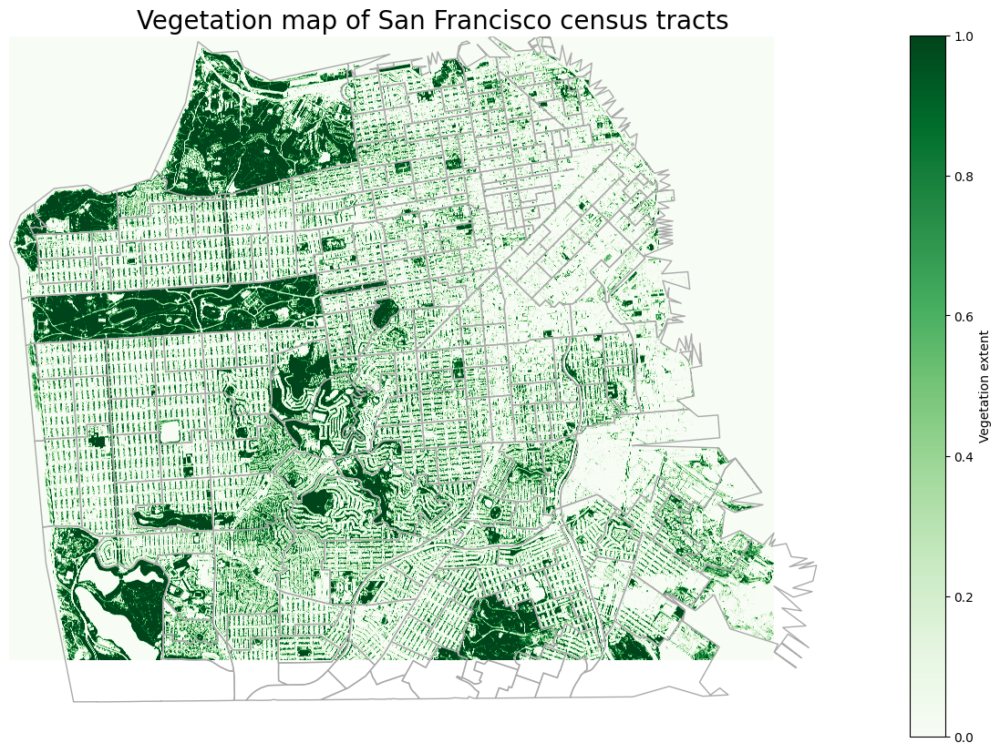

In [39]:
# open the SF vegetation tiff file
with rio.open(out_tif) as src:
    veg_data = src.read(1)
    veg_crs = src.crs
    veg_extent = rio.plot.plotting_extent(src)

# ensure the census tracts are in the same CRS as the vegetation data
sf_gdf_clipped = sf_gdf_clipped.to_crs(veg_crs)

# initialize plot
fig, ax = plt.subplots(figsize=(15, 10))

# plot the vegetation data
im = ax.imshow(veg_data, cmap='Greens', extent=veg_extent)
fig.colorbar(im, ax=ax, label='Vegetation extent')

# plot the boundaries of the census tracts on top
sf_gdf_clipped.boundary.plot(ax=ax, edgecolor='darkgray', linewidth=1)

ax.set_title('Vegetation map of San Francisco census tracts', fontsize=20)

# remove axes
ax.set_axis_off()

plt.show()

### Overlay shapefile on raster data

Here we will calculate the percentage of tree canopy cover in each census tract. 


In [41]:
inraster = 'data-part2/maskedSF-naip.tif'
input_zone_polygon = 'data-part2/sf_census_tracts.shp'
output_shp_res = 'data-part2/vegCoverCensus-tract.shp'

# open the raster datasets
naip_dataset = rio.open(inraster)

# prepare the polygon shapefile and then do the overlay of the raster data and the vector data
lyr = fiona.open(input_zone_polygon)
schema = lyr.schema
schema['properties']['ndvi'] = 'float'

# create list to set up gdf
gdf_list = []

with fiona.open(output_shp_res, 'w', driver = "ESRI Shapefile", crs = lyr.crs, schema=schema) as output:
    for idx, feat in enumerate(lyr):
        props = feat['properties']
        geom = feat['geometry']
        shape = [geom] # the rasterio need the list, therefore, create a list
        
        # mask the raster using the polygon
        outNAIP_image, out_transform = rio.mask.mask(naip_dataset, shape, 
                                                          nodata = 0,
                                                          crop=True)
        
        # calculate the ndvi from the clipped naip img, convert the int to float using numpy
        nir = np.float32(outNAIP_image[0, :, :])
        red = np.float32(outNAIP_image[1, :, :])
        ndvi = (nir - red)/(nir + red + 0.000001)
        
        # calculate the mean ndvi value
        mean_val = np.sum(ndvi)/np.count_nonzero(ndvi)
        
        # update the calculated ndvi value to the field
        props['ndvi'] = mean_val

        # unpack the properties dictionary and add them as individual columns
        extracted_props = {
            'STATEFP': props['STATEFP'],
            'COUNTYFP': props['COUNTYFP'],
            'TRACTCE': props['TRACTCE'],
            'GEOID': props['GEOID'],
            'NAME': props['NAME'],
            'NAMELSAD': props['NAMELSAD'],
            'MTFCC': props['MTFCC'],
            'FUNCSTAT': props['FUNCSTAT'],
            'ALAND': props['ALAND'],
            'AWATER': props['AWATER'],
            'INTPTLAT': props['INTPTLAT'],
            'INTPTLON': props['INTPTLON'],
            'ndvi': props['ndvi']
        }

        # write the updated feature with extracted properties to the shapefile
        output.write({'properties': extracted_props, 'geometry': geom})

        # append the geometry and extracted properties directly to the list for gdf conversion
        gdf_list.append({'geometry': geom, **extracted_props})

# convert the list of features into a gdf for mapping
sf_ndvi = gpd.GeoDataFrame(gdf_list, crs=lyr.crs)


/var/folders/xd/w__5x95d37b_lkks4djd2m9h0000gp/T/ipykernel_596/4283241365.py:36: FionaDeprecationWarning: instances of this class -- CRS, geometry, and feature objects -- will become immutable in fiona version 2.0
  props['ndvi'] = mean_val
/var/folders/xd/w__5x95d37b_lkks4djd2m9h0000gp/T/ipykernel_596/4283241365.py:36: FionaDeprecationWarning: instances of this class -- CRS, geometry, and feature objects -- will become immutable in fiona version 2.0
  props['ndvi'] = mean_val
/var/folders/xd/w__5x95d37b_lkks4djd2m9h0000gp/T/ipykernel_596/4283241365.py:36: FionaDeprecationWarning: instances of this class -- CRS, geometry, and feature objects -- will become immutable in fiona version 2.0
  props['ndvi'] = mean_val
/var/folders/xd/w__5x95d37b_lkks4djd2m9h0000gp/T/ipykernel_596/4283241365.py:36: FionaDeprecationWarning: instances of this class -- CRS, geometry, and feature objects -- will become immutable in fiona version 2.0
  props['ndvi'] = mean_val
/var/folders/xd/w__5x95d37b_lkks4djd

## NDVI map of San Francisco

Here, we visualize a map of San Francisco census tracts by mean NDVI value.

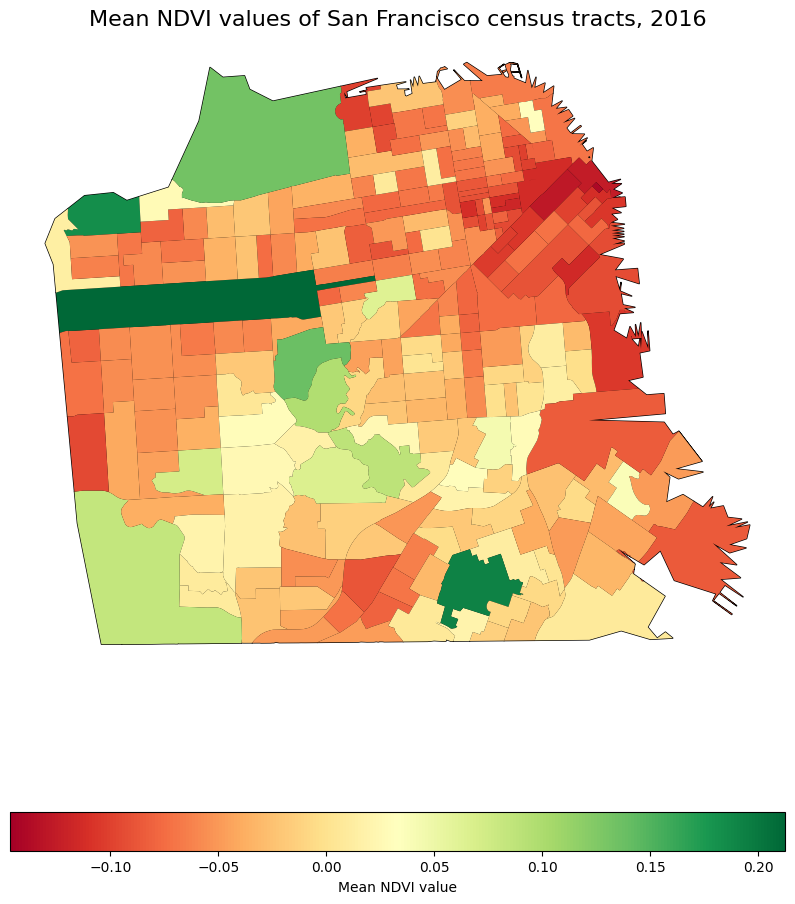

In [43]:
# initialize plot
fig, ax = plt.subplots(figsize=(10, 12))

# plot the geometries of the census tracts
sf_ndvi.plot(ax=ax, color='lightgray', edgecolor='black')

# plot the NDVI values
sf_ndvi.plot(ax=ax, column='ndvi', cmap='RdYlGn', legend=True,
             legend_kwds={'label': "Mean NDVI value",
                          'orientation': "horizontal"})

# set title and labels
ax.set_title('Mean NDVI values of San Francisco census tracts, 2016', fontsize=16)

# remove axes
ax.set_axis_off()

# show plot
plt.show()